<a href="https://colab.research.google.com/github/anayp331/anayp331/blob/main/img_seg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/content/drive/MyDrive/archive (7)/test'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_21.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_2.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_12.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_35.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_72.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_25.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_83.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_38.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_41.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_100x_22.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_400x_119.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_400x_124.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_400x_104.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_400x_106.jpg
/content/drive/MyDrive/archive (7)/test/Normal/Normal_400x_122.jpg
/conte

CAM, CapsNets, SENet

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import keras
import tensorflow as tf
from tqdm import tqdm
from tensorflow.keras.applications import *
from tensorflow.keras.applications.densenet import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,MaxPooling2D,Dropout,Flatten,BatchNormalization
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report

In [5]:
Image_size = 224
input_shape = (224,224,3)
train_dir = '/content/drive/MyDrive/archive (7)/train'
test_dir = '/content/drive/MyDrive/archive (7)/test'
val_dir= '/content/drive/MyDrive/archive (7)/val'
train_gen = ImageDataGenerator(preprocessing_function=preprocess_input,rotation_range=45, width_shift_range=0.2,
      height_shift_range=0.2,
      horizontal_flip=True).flow_from_directory(
              directory = os.path.join(train_dir),
              target_size=(Image_size,Image_size),
              batch_size =32,shuffle=True,
             class_mode='categorical')
test_gen = ImageDataGenerator(preprocessing_function=preprocess_input,rotation_range=45, width_shift_range=0.2,
      height_shift_range=0.2,
      horizontal_flip=True).flow_from_directory(
              directory = os.path.join(test_dir),
              target_size=(Image_size,Image_size),
              batch_size =32,shuffle=True,
             class_mode='categorical')
val_gen = ImageDataGenerator(preprocessing_function=preprocess_input,rotation_range=45, width_shift_range=0.2,
      height_shift_range=0.2,
      horizontal_flip=True).flow_from_directory(
              directory = os.path.join(val_dir),
              target_size=(Image_size,Image_size),
              batch_size =32,shuffle=True,
             class_mode='categorical')

Found 4970 images belonging to 2 classes.
Found 126 images belonging to 2 classes.
Found 120 images belonging to 2 classes.


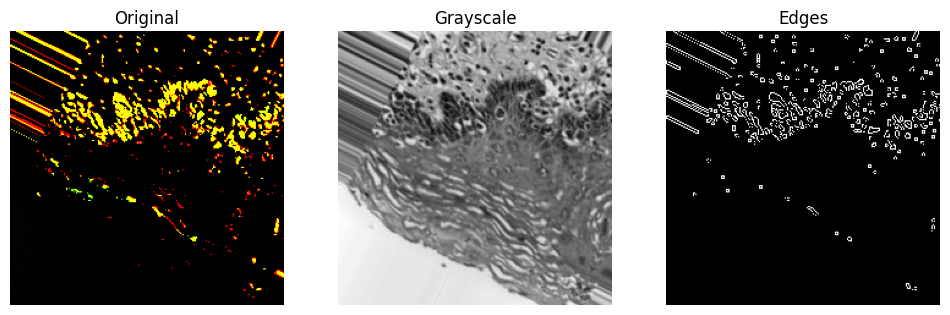

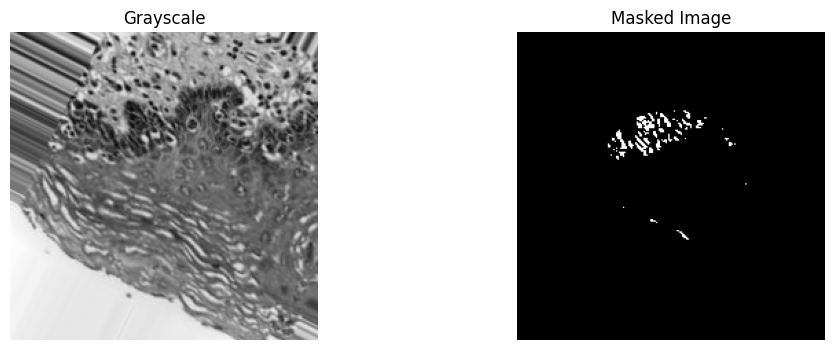

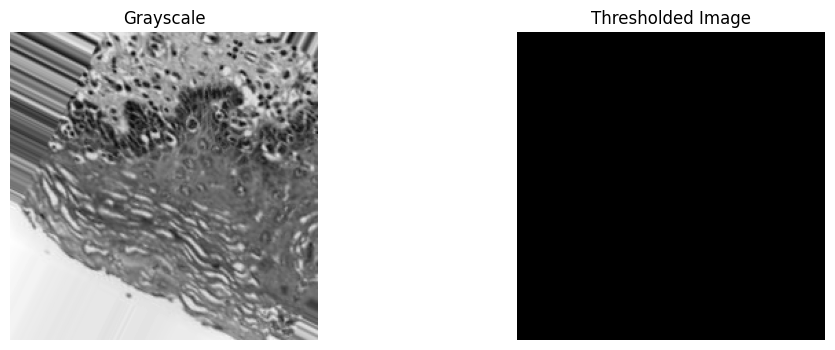

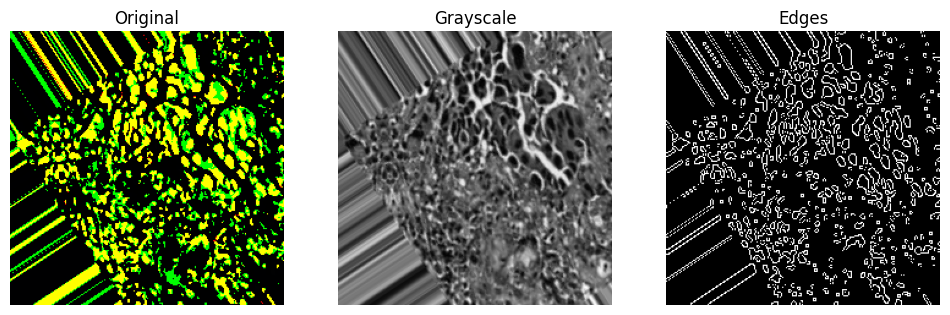

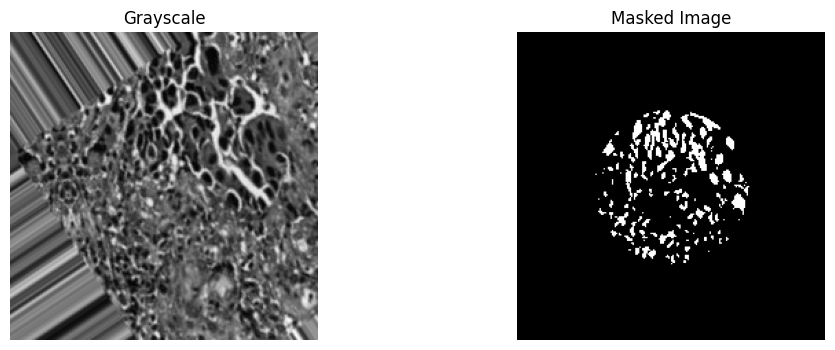

...

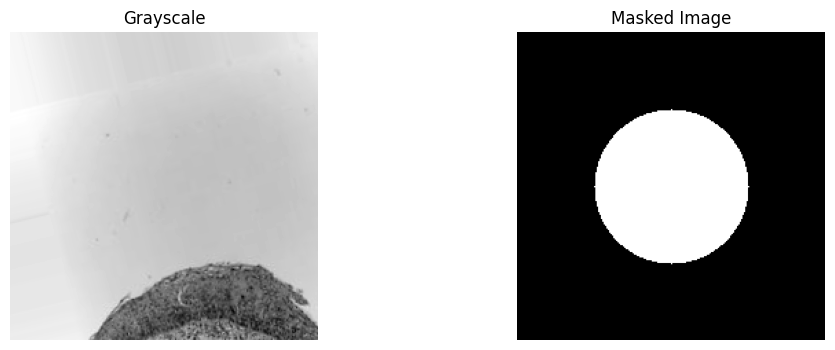

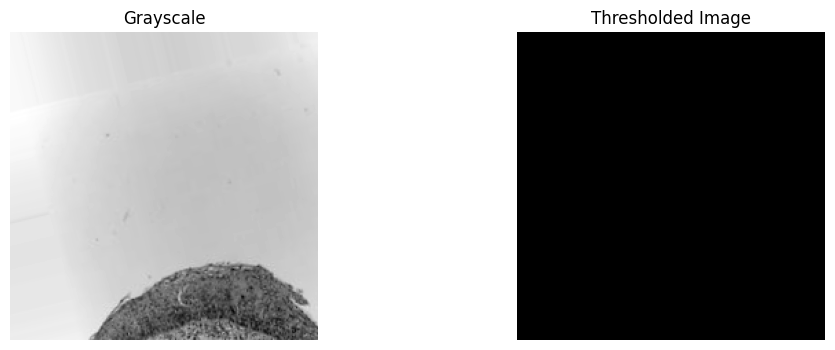

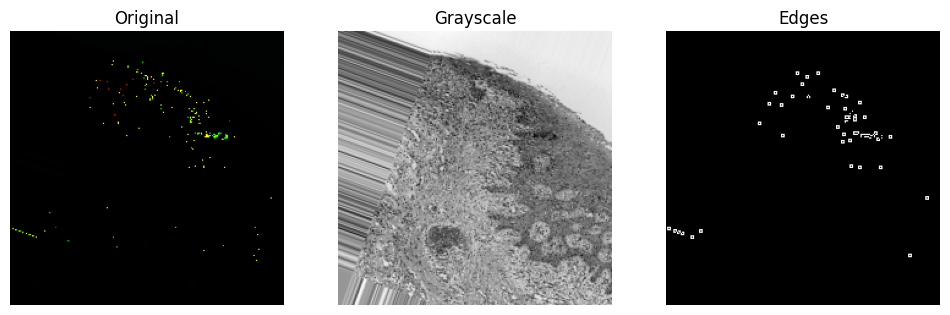

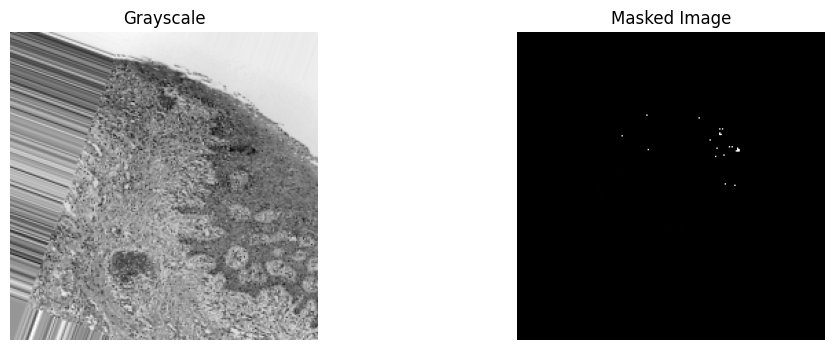

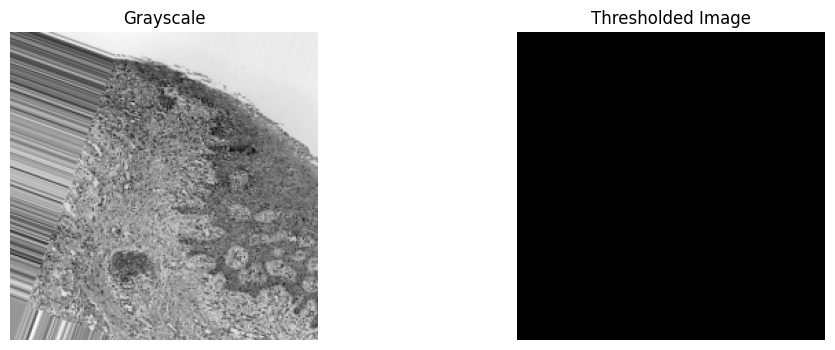

In [6]:
for i in range(10):  # Assuming 10 epochs
    images, _ = next(train_gen)  # Get a batch of augmented images
    # Process only the first 4 images
    for j in range(4):
        # Grayscaling
        gray_image = cv2.cvtColor(images[j], cv2.COLOR_RGB2GRAY)

        # Display original and grayscaled images
        plt.figure(figsize=(12, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(images[j].astype(np.uint8))
        plt.title('Original')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(gray_image, cmap='gray')
        plt.title('Grayscale')
        plt.axis('off')

        # Convert grayscale image to uint8
        gray_image_uint8 = gray_image.astype(np.uint8)

        # Edge detection using Canny edge detector
        edges = cv2.Canny(gray_image_uint8, 100, 200)  # Adjust thresholds as needed

        plt.subplot(1, 3, 3)
        plt.imshow(edges, cmap='gray')
        plt.title('Edges')
        plt.axis('off')
        plt.show()

        # Masking
        # Assuming you have a predefined mask or region of interest (ROI)
        # Let's create a simple circular mask for demonstration
        mask = np.zeros_like(gray_image_uint8)
        mask_radius = min(gray_image_uint8.shape) // 4
        center = (gray_image_uint8.shape[1] // 2, gray_image_uint8.shape[0] // 2)
        cv2.circle(mask, center, mask_radius, 255, -1)  # Create circular mask
        # Resize mask to match the size of the grayscale image
        resized_mask = cv2.resize(mask, (gray_image_uint8.shape[1], gray_image_uint8.shape[0]))

        masked_image = cv2.bitwise_and(gray_image_uint8, gray_image_uint8, mask=resized_mask)

        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.imshow(gray_image, cmap='gray')
        plt.title('Grayscale')
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(masked_image, cmap='gray')
        plt.title('Masked Image')
        plt.axis('off')
        plt.show()

        # Image segmentation (example using simple thresholding)
        _, binary_threshold = cv2.threshold(gray_image, 100, 255, cv2.THRESH_BINARY)

        plt.figure(figsize=(12, 4))
        plt.subplot(1, 2, 1)
        plt.imshow(gray_image, cmap='gray')
        plt.title('Grayscale')
        plt.axis('off')

        plt.subplot(1, 2, 2)
        plt.imshow(binary_threshold, cmap='gray')
        plt.title('Thresholded Image')
        plt.axis('off')
        plt.show()


In [8]:
%pip install efficientnet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 3.9 MB/s eta 0:00:00


In [9]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from efficientnet.tfkeras import EfficientNetB0

# Define input shape
input_shape = (224, 224, 3)

# Load EfficientNetB0 model pre-trained on ImageNet
base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)

# Freeze the pre-trained layers
base_model.trainable = False

# Add custom classification head
x = GlobalAveragePooling2D()(base_model.output)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)  # Adding dropout for regularization
output = Dense(2, activation='softmax')(x)  # Assuming num_classes is the number of output classes

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Display model summary
model.summary()


16804768/16804768 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_conv (Conv2D)        │ (None, 112, 112, 32)   │            864 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_bn                   │ (None, 112, 112, 32)   │            128 │ stem_conv[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stem_activation           │ (None, 112, 112, 32)   │              0 │ stem_bn[0][0]          │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_dwconv            │ (None, 112, 112, 32)   │            288 │ stem_activation[0][0]  │
│ (DepthwiseConv2D)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_bn                │ (None, 112, 112, 32)   │            128 │ block1a_dwconv[0][0]   │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_activation        │ (None, 112, 112, 32)   │              0 │ block1a_bn[0][0]       │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_squeeze        │ (None, 32)             │              0 │ block1a_activation[0]… │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_reshape        │ (None, 1, 1, 32)       │              0 │ block1a_se_squeeze[0]… │
│ (Reshape)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_reduce         │ (None, 1, 1, 8)        │            264 │ block1a_se_reshape[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_expand         │ (None, 1, 1, 32)       │            288 │ block1a_se_reduce[0][… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_se_excite         │ (None, 112, 112, 32)   │              0 │ block1a_activation[0]… │
│ (Multiply)                │                        │                │ block1a_se_expand[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_project_conv      │ (None, 112, 112, 16)   │            512 │ block1a_se_excite[0][… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1a_project_bn        │ (None, 112, 112, 16)   │             64 │ block1a_project_conv[… │
│ (BatchNormalization) 

 Total params: 4,706,462 (17.95 MB)

 Trainable params: 656,898 (2.51 MB)

 Non-trainable params: 4,049,564 (15.45 MB)

Epoch 1/10


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


156/156 ━━━━━━━━━━━━━━━━━━━━ 1348s 8s/step - accuracy: 0.7095 - loss: 0.5972 - val_accuracy: 0.7750 - val_loss: 0.4067
Epoch 2/10
156/156 ━━━━━━━━━━━━━━━━━━━━ 148s 907ms/step - accuracy: 0.8161 - loss: 0.3842 - val_accuracy: 0.7833 - val_loss: 0.3816
Epoch 3/10
156/156 ━━━━━━━━━━━━━━━━━━━━ 151s 938ms/step - accuracy: 0.8314 - loss: 0.3622 - val_accuracy: 0.8333 - val_loss: 0.4109
Epoch 4/10
156/156 ━━━━━━━━━━━━━━━━━━━━ 141s 871ms/step - accuracy: 0.8370 - loss: 0.3471 - val_accuracy: 0.8833 - val_loss: 0.3528
Epoch 5/10
156/156 ━━━━━━━━━━━━━━━━━━━━ 138s 851ms/step - accuracy: 0.8685 - loss: 0.3039 - val_accuracy: 0.8250 - val_loss: 0.4516
Epoch 6/10
156/156 ━━━━━━━━━━━━━━━━━━━━ 142s 868ms/step - accuracy: 0.8658 - loss: 0.2993 - val_accuracy: 0.8333 - val_loss: 0.4430
Epoch 7/10
156/156 ━━━━━━━━━━━━━━━━━━━━ 198s 840ms/step - accuracy: 0.8765 - loss: 0.2887 - val_accuracy: 0.8250 - val_loss: 0.3772
Epoch 8/10
156/156 ━━━━━━━━━━━━━━━━━━━━ 144s 856ms/step - accuracy: 0.8858 - loss: 0.2710

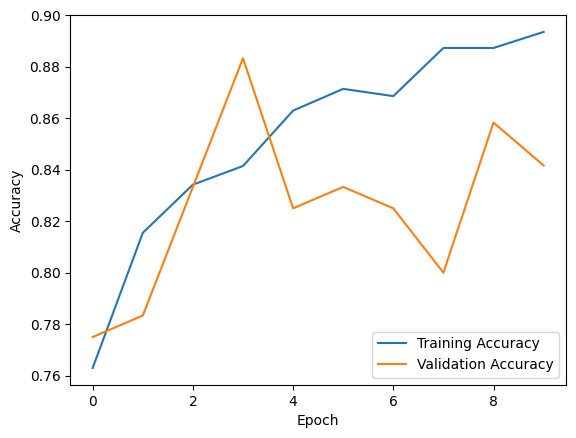

In [10]:
from tqdm import tqdm

# Train the model with tqdm progress bar
history = model.fit(train_gen, epochs=10, validation_data=val_gen, verbose=1)

# Evaluate the model
loss, accuracy = model.evaluate(test_gen)
print(f'Test Loss: {loss}')
print(f'Test Accuracy: {accuracy}')

# Plot training history
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
# history2 = model.fit(train_gen, epochs=30, validation_data=val_gen, verbose=0)

# # Evaluate the model
# loss, accuracy = model.evaluate(test_gen)
# print(f'Test Loss: {loss}')
# print(f'Test Accuracy: {accuracy}')

# # Plot training history
# import matplotlib.pyplot as plt

# plt.plot(history2.history['accuracy'], label='Training Accuracy')
# plt.plot(history2.history['val_accuracy'], label='Validation Accuracy')
# plt.xlabel('Epoch')
# plt.ylabel('Accuracy')
# plt.legend()
# plt.show()

In [11]:
%pip install pickle5

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.1/132.1 kB 6.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pickle5: filename=pickle5-0.0.11-cp310-cp310-linux_x86_64.whl size=255313 sha256=f71165032f6563abec7de1a75fa38e12cb6bce9226c91f2a9f2b4cfc5344cccc
  Stored in directory: /root/.cache/pip/wheels/7d/14/ef/4aab19d27fa8e58772be5c71c16add0426acf9e1f64353235c
Successfully built pickle5


In [12]:
# Save the entire model to a HDF5 file
model.save('model.h5')

In [13]:
import numpy as np
import cv2

def generate_cam(model, image):
    # Expand dimensions to add batch dimension
    image = np.expand_dims(image, axis=0)

    # Get the final convolutional layer
    final_conv_layer = model.get_layer('top_conv')

    # Get the gradient tape
    with tf.GradientTape() as tape:
        # Get the output of the final convolutional layer
        conv_output = final_conv_layer(image)
    # Get the gradient of the predicted class with respect to the final convolutional layer output
    grads = tape.gradient(conv_output, final_conv_layer.output)

    # Global average pooling
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # Multiply each channel in the feature map array by "how important this channel is" with regard to the target class
    conv_output = conv_output[0]  # Get the feature map
    for i in range(conv_output.shape[-1]):
        conv_output[:, :, i] *= pooled_grads[i]

    # Generate class activation map (CAM)
    cam = np.mean(conv_output, axis=-1)
    cam = np.maximum(cam, 0)  # ReLU
    cam /= np.max(cam)  # Normalize

    return cam


# Choose an image from the test set
image_index = 0  # Choose the index of the image
image = test_gen[image_index][0][0]  # Get the image from the test generator

# Generate CAM
cam = generate_cam(model, image)

# Resize CAM to match the image size
cam = cv2.resize(cam, (image.shape[1], image.shape[0]))

# Normalize CAM to values between 0 and 255
cam = (255 * cam).astype(np.uint8)

# Apply jet colormap to visualize the CAM
heatmap = cv2.applyColorMap(cam, cv2.COLORMAP_JET)

# Superimpose the heatmap on the original image
superimposed_img = heatmap * 0.4 + image.astype(np.uint8)  # Adjust the intensity factor (0.4) as needed

# Display the original image and the superimposed image with CAM
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(image)
plt.title('Original Image')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(superimposed_img)
plt.title('CAM')
plt.axis('off')
plt.show()


ValueError: Input 0 of layer "top_conv" is incompatible with the layer: expected axis -1 of input shape to have value 320, but received input with shape (1, 224, 224, 3)

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Layer, GlobalAveragePooling2D, Reshape, Dense, Multiply

class SEBlock(Layer):
    def __init__(self, reduction_ratio=16):
        super(SEBlock, self).__init__()
        self.reduction_ratio = reduction_ratio

    def build(self, input_shape):
        # Calculate the number of channels
        num_channels = input_shape[-1]

        # Define the number of units for the fully connected layers
        num_reduced_units = max(1, num_channels // self.reduction_ratio)

        # Define the fully connected layers
        self.fc1 = Dense(num_reduced_units, activation='relu')
        self.fc2 = Dense(num_channels, activation='sigmoid')

        # Reshape layer to match the shape of the input tensor
        self.reshape = Reshape((1, 1, num_channels))

    def call(self, inputs):
        # Global average pooling along the spatial dimensions
        squeeze_tensor = GlobalAveragePooling2D()(inputs)

        # Apply fully connected layers
        excitation = self.fc1(squeeze_tensor)
        excitation = self.fc2(excitation)

        # Reshape excitation tensor to match the shape of the input tensor
        excitation = self.reshape(excitation)

        # Scale the input tensor by the excitation tensor
        scale_tensor = Multiply()([inputs, excitation])

        return scale_tensor


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Define your model
model2 = Sequential([
    Conv2D(64, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D((2, 2)),
    SEBlock(),  # Add SEBlock after a convolutional layer
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(256, activation='relu'),
    Dense(2, activation='softmax')  # Assuming binary classification
])

# Compile the model
model2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
history3 = model2.fit(train_gen, epochs=30, validation_data=val_gen)

# Evaluate the model
loss, accuracy = model2.evaluate(test_gen)
print(f'Test Loss: {loss}')
print(f'Test Accuracy: {accuracy}')


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/30


# --------------------------------------------------------------

In [ ]:
%pip install SimpleITK

In [ ]:
import numpy as np
import os
import SimpleITK as sitk
from tensorflow.keras.preprocessing import image

# Define a function to segment tumor and calculate volume for a single image
def segment_tumor_and_calculate_volume(image_path, threshold_value):
    # Load the image
    img = image.load_img(image_path, target_size=(Image_size, Image_size))
    img_array = image.img_to_array(img)

    # Perform thresholding to segment the tumor
    tumor_mask = np.where(img_array > threshold_value, 1, 0)  # Adjust threshold_value as needed

    # Connected component labeling to identify individual regions
    labeled_mask = sitk.GetImageFromArray(tumor_mask.astype(np.uint8))
    labeled_mask = sitk.ConnectedComponent(labeled_mask)

    # Compute the statistics of the labeled components
    label_shape_analysis = sitk.LabelShapeStatisticsImageFilter()
    label_shape_analysis.Execute(labeled_mask)

    # Get the statistics of the largest connected component
    num_labels = label_shape_analysis.GetNumberOfLabels()
    max_label = 1
    max_size = 0
    for label in range(1, num_labels + 1):
        size = label_shape_analysis.GetNumberOfPixels(label)
        if size > max_size:
            max_size = size
            max_label = label

    # Extract the largest connected component (assumed to be the tumor)
    tumor_mask = sitk.BinaryThreshold(labeled_mask, max_label, max_label, 1, 0)

    # Calculate tumor volume
    tumor_volume = sitk.GetArrayFromImage(tumor_mask).sum() * np.prod(labeled_mask.GetSpacing())

    return tumor_volume

# Set the threshold value for tumor segmentation
threshold_value = 128

# Get the list of image paths from the ImageDataGenerator
train_image_paths = train_gen.filepaths

# Calculate tumor volume for each image
train_tumor_volumes = [segment_tumor_and_calculate_volume(image_path, threshold_value) for image_path in train_image_paths]

# Print the calculated tumor volumes
print("Train set tumor volumes:", train_tumor_volumes)

Train set tumor volumes: [128729.0, 125766.0, 105219.0, 114265.0, 113139.0, 145297.0, 141065.0, 144936.0, 146212.0, 146281.0, 124226.0, 128881.0, 119046.0, 123132.0, 122326.0, 137967.0, 111172.0, 131271.0, 127628.0, 131255.0, 114330.0, 84006.0, 112558.0, 97446.0, 128863.0, 61478.0, 119577.0, 124262.0, 121209.0, 123062.0, 123429.0, 125181.0, 113605.0, 97053.0, 115468.0, 115839.0, 122781.0, 126176.0, 127303.0, 139924.0, 141499.0, 143722.0, 105381.0, 116412.0, 127769.0, 128316.0, 139599.0, 99672.0, 90217.0, 93872.0, 97302.0, 104578.0, 143686.0, 97053.0, 140924.0, 131547.0, 111497.0, 109265.0, 106070.0, 100227.0, 96993.0, 91975.0, 95039.0, 97304.0, 99166.0, 111155.0, 103159.0, 96393.0, 93588.0, 117834.0, 118473.0, 108264.0, 112573.0, 113886.0, 119874.0, 113866.0, 102651.0, 103587.0, 101408.0, 139260.0, 86944.0, 97317.0, 92064.0, 90673.0, 85052.0, 83520.0, 90740.0, 92948.0, 88594.0, 94842.0, 97602.0, 85952.0, 97275.0, 104841.0, 112830.0, 97814.0, 69603.0, 137772.0, 48840.0, 94056.0, 100014.

Visualize 1st ten images for 3d visualization

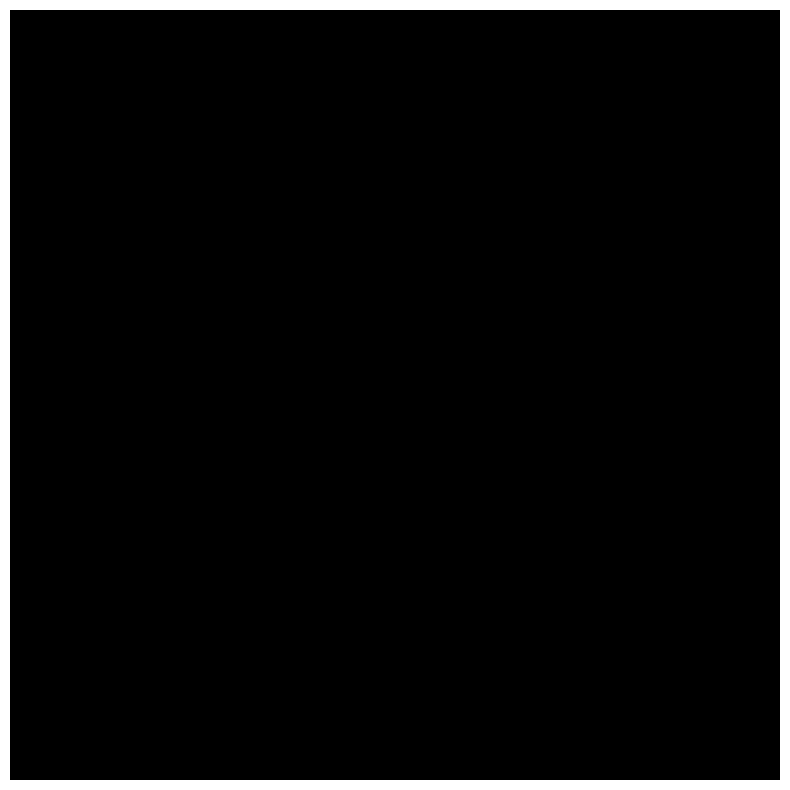

In [ ]:
import numpy as np
import os
import SimpleITK as sitk
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt

# Define a function to segment tumor using thresholding and morphological operations
def segment_tumor(image_path, threshold_value):
    # Load the image
    img = image.load_img(image_path, target_size=(Image_size, Image_size), color_mode='grayscale')
    img_array = image.img_to_array(img)

    # Perform thresholding to segment the tumor
    tumor_mask = np.where(img_array > threshold_value, 1, 0)

    # Apply morphological operations to refine the segmentation
    # You may need to adjust the kernel size and iterations based on your data
    kernel = np.ones((5, 5), np.uint8)
    tumor_mask = cv2.morphologyEx(tumor_mask.astype(np.uint8), cv2.MORPH_CLOSE, kernel)
    tumor_mask = cv2.morphologyEx(tumor_mask.astype(np.uint8), cv2.MORPH_OPEN, kernel)

    return tumor_mask

# Get the list of image paths from the ImageDataGenerator
train_image_paths = train_gen.filepaths[:10]  # Limiting to first 10 images for demonstration

# Set the threshold value for tumor segmentation
threshold_value = 128

# Segment tumor for each image using thresholding and morphological operations
segmented_tumor_masks = []
for image_path in train_image_paths:
    tumor_mask = segment_tumor(image_path, threshold_value)
    segmented_tumor_masks.append(tumor_mask)

# Stack the segmented tumor masks along the z-axis to form a 3D tumor volume
if segmented_tumor_masks:
    train_3d_tumor_volume = np.stack(segmented_tumor_masks, axis=-1)

    # Check if the 3D tumor volume is not empty and has the expected shape
    if len(train_3d_tumor_volume.shape) == 3:
        # Visualize the 3D tumor volume using matplotlib
        fig = plt.figure(figsize=(10, 10))
        middle_slice_index = train_3d_tumor_volume.shape[2] // 2
        plt.imshow(train_3d_tumor_volume[:, :, middle_slice_index], cmap='gray')  # Show the middle slice
        plt.axis('off')
        plt.show()
    else:
        print("Error: Unable to create 3D tumor volume from the provided data.")
else:
    print("Error: No tumor masks were generated from the provided data.")


In [ ]:
import numpy as np
import os
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import preprocess_input

# Define constants
Image_size = 224
batch_size = 32
num_epochs = 10

# Define CNN model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(Image_size, Image_size, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(256, activation='relu'),
    Dense(1)
])

# Compile the model
model.compile(optimizer='adam', loss='mean_squared_error')

# Load data generators
train_gen = train_gen
test_gen = test_gen
val_gen = val_gen

# Train the model
model.fit(train_gen, epochs=num_epochs, validation_data=val_gen)

# Evaluate the model
loss = model.evaluate(test_gen)
print("Test loss:", loss)

# Prediction example
sample_image_path = '/kaggle/input/dataset/test/OSCC/OSCC_100x_101.jpg'
sample_img = image.load_img(sample_image_path, target_size=(Image_size, Image_size))
sample_img_array = image.img_to_array(sample_img)
sample_img_array = np.expand_dims(sample_img_array, axis=0)  # Add batch dimension
preprocessed_sample_img_array = preprocess_input(sample_img_array)
tumor_volume_prediction = model.predict(preprocessed_sample_img_array)
print("Predicted tumor volume:", tumor_volume_prediction)


In [ ]:
# Save the entire model to a HDF5 file
model.save('model2.h5')